## Unveiling Urban Road Challenges - NYC Pothole Prediction
This project focuses on predicting NYC potholes location from the historical data based on zip_codes, latitudes, longitudes, street names, weather patterns and treating it as a Regression problem. 
The objective of this project is to improve the process of repairing potholes and provide authorities with timely insights into areas where potholes may pose significant challenges. Our main target variables are
* days to fix a pothole
* latitudes and longitudes

### Wokrflow
1.  Load Data
2.  Describe Data
3.  Data Cleaning (checking nulls, duplicates)
4.  Perform Basic Analysis
5.  Present and Plot the insights
6.  Feature Engineering
7.  Statistical Analysis
8.  Check for Class Imbalance
9.  Initial Modelling
10. Advance Modelling (PCA, GridSearchCV, Hyperparameter Tuning, Data Scaling)
11. Discuss the best model, its assumptions and errors

In [140]:
# import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import re
import seaborn as sns

# import modules
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV

import warnings
warnings.filterwarnings('ignore')

#### Load and Describe Data

In [141]:
df = pd.read_csv("../Data/Street_Pothole_Work_Orders_-_Closed__Dataset_.csv") #importing dataset
df.head(10)

,the_geom,DefNum,InitBy,HouseNum,OFT,OnFaceName,OnPrimName,FrmPrimNam,ToPrimName,SpecLoc,Boro,Source,RptDate,RptClosed,Shape_Leng
0,MULTILINESTRING ((-73.88643460204372 40.630776...,DB2004041154,YRD,NaN,373480377030377030,ROCKAWAY PY,ROCKAWAY PARKWAY,BELT PARKWAY,BELT PARKWAY,NaN,B,YRD,02/08/2004,01/27/2023,557.690465
1,MULTILINESTRING ((-73.94380842208851 40.584992...,DB2004287021,CSC,NaN,318630377030377030,BEDFORD AV,BEDFORD AVENUE,BELT PARKWAY,BELT PARKWAY,SB ON BEDFORD_UNDERNEATH OVERPASS,B,CTZ,10/13/2004,02/14/2013,109.124234
2,MULTILINESTRING ((-73.98570910180842 40.641185...,DB2006085009,CSC,NaN,306380308480308530,13 AV,13 AVENUE,38 STREET,39 STREET,I/F/O B16 BUS STOP,B,CTZ,03/26/2006,10/11/2014,260.495098
3,MULTILINESTRING ((-73.93487210852416 40.679593...,DB2007166005,CSC,1688,342730355530375430,FULTON ST,FULTON STREET,LEWIS AVENUE,SCHENECTADY AVENUE,POTHOLE NEAR CURB I/F/O ADDRESS,B,CTZ,06/15/2007,01/14/2011,549.255973
4,MULTILINESTRING ((-73.97793940872546 40.689806...,DB2009352004,CSC,45,380030331530342730,ST FELIX ST,ST FELIX STREET,DEKALB AVENUE,FULTON STREET,"4"" DEEP",B,CTZ,12/18/2009,01/06/2010,836.436669
5,MULTILINESTRING ((-73.97501506812618 40.640761...,DB2009362038,CSC,514,313830335030367730,AV C,AVENUE C,EAST 5 STREET,OCEAN PARKWAY,ONE POTHOLE I/F/O DRIVE WAY RIGHT OFF THE CURB,B,CTZ,12/28/2009,01/04/2010,385.456668
6,MULTILINESTRING ((-73.92232548215823 40.586294...,DB2009362066,CSC,NaN,342890356960375990,GAIN CT,GAIN COURT,LOIS AVENUE,SEBA AVENUE,CLOSER TO SEBA AVE,B,CTZ,12/28/2009,01/05/2010,529.261511
7,MULTILINESTRING ((-73.96802285162667 40.624450...,DB2009363041,CSC,808,314080335130335180,AV J,AVENUE J,EAST 8 STREET,EAST 9 STREET,IN FRONT OF ADDRESS NEAR BUS STOP,B,CTZ,12/29/2009,01/04/2010,259.706337
8,MULTILINESTRING ((-73.9080474319009 40.6954161...,DB2009363045,CSC,1402,347030352130394730,HANCOCK ST,HANCOCK STREET,IRVING AVENUE,WYCKOFF AVENUE,2 POTHOLES IN FRONT OF 1402 HANCOCK ST,B,CTZ,12/29/2009,01/10/2010,708.233651
9,MULTILINESTRING ((-73.95291388704382 40.706700...,DB2009364034,CSC,NaN,323230349430364630,BDWY,BROADWAY,HEWES STREET,NEW MONTROSE AVENUE,SEVERAL ON STREET,B,CTZ,12/30/2009,01/10/2010,304.584886


In [142]:
df.shape

(360730, 15)

In [143]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 360730 entries, 0 to 360729
Data columns (total 15 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   the_geom    360730 non-null  object 
 1   DefNum      360730 non-null  object 
 2   InitBy      360730 non-null  object 
 3   HouseNum    236000 non-null  object 
 4   OFT         360730 non-null  int64  
 5   OnFaceName  360067 non-null  object 
 6   OnPrimName  360653 non-null  object 
 7   FrmPrimNam  360700 non-null  object 
 8   ToPrimName  360624 non-null  object 
 9   SpecLoc     120304 non-null  object 
 10  Boro        360730 non-null  object 
 11  Source      360730 non-null  object 
 12  RptDate     360730 non-null  object 
 13  RptClosed   360730 non-null  object 
 14  Shape_Leng  360730 non-null  float64
dtypes: float64(1), int64(1), object(13)
memory usage: 41.3+ MB


We have 360730 rows and 15 columns in this data. Out of 15 Features, we have 13 objects, 1 Float and 1 Int.

## Data Cleaning

In [144]:
# checking nulls in the dataset
total_null_count = df.isnull().sum()
print(total_null_count)

the_geom           0
DefNum             0
InitBy             0
HouseNum      124730
OFT                0
OnFaceName       663
OnPrimName        77
FrmPrimNam        30
ToPrimName       106
SpecLoc       240426
Boro               0
Source             0
RptDate            0
RptClosed          0
Shape_Leng         0
dtype: int64


We have a large number of nulls in these columns "House_num", "specific" , "OnFaceName", "ToPrimName" location. The first approach would be to fill the missing data as we have large nuumber of nulls we can't actually replace or impute the missing values from other columns.
The approach we'll be taking is to feature engineer the required data from "the_geom" column, we'll reverse the longitudes and latitudes to extract the address for every location.
I am dropping the columns "House_Num" and "SpecLoc" as we won't be needing them.

In [145]:
df = df.drop(['HouseNum', 'SpecLoc'], axis=1) 

The Data is starting from year 2004 whereas there are only 1 report per year for potholes between year 2004 and 2008. There are only 30 reports for year 2009. So I am filtering the data and starting from year 2010 to remove the outliers and to have real-time insights

In [146]:
# convert datetime object to datetime data type
df['RptDate'] = df['RptDate'].astype('datetime64[ns]')  
df['RptClosed'] = df['RptClosed'].astype('datetime64[ns]')

date_threshold = pd.to_datetime('2009-12-31')

df = df[df['RptDate'] > date_threshold]

Resetting the index as it will be difficult to interpret the data without a numeric index, we already have "DefNum" but it is hard to interpret easily as it have string syntax

In [147]:
df['index'] = range(0, len(df))

### Feature Engineering
To improve our model and make it learn more about the pothole occurences I have feature engineered some columns.
* month
* days to fix a pothole
* zipcode
* street names
* weather patterns (TMIN, TMAX, SNOW, PRECP)

#### Lat and Lon from "the_geom" column
We have a feature of longtitudes and latitudes named as "the_geom", I'll feature engineer zip_codes and it will be our target variable.
For that I am first extracting the longitudes and latitudes from the_geom column using regex.
I am looping through the "the_geom" column and selecting the first pair of longitudes and latitudes in each row.

In [148]:
pattern = r'(-?\d+\.\d+)\s(-?\d+\.\d+)' #regex for extracting longtitude and latitude from the "the_geom" string

# Initialize empty lists to store longitude and latitude string
longitudes = []
latitudes = []

# Loop through each string in the list
for coordinates_string in df['the_geom']:
    # Find all matches of latitude and longitude using regular expression
    matches = re.findall(pattern, coordinates_string)
    # Extract the first pair of coordinates
    if matches:
        lon, lat = matches[0]
        longitudes.append(float(lon))
        latitudes.append(float(lat))

# Print the extracted coordinates
print("First pair of longitude and latitude:", longitudes[0] , latitudes[0])

First pair of longitude and latitude: -73.92993757815543 40.59714681302245


In [149]:
df['lon'] = longitudes
df['lat'] = latitudes

Then I am using the library "Geopy" and reversing the longitudes and latitudes to get the address and zip_codes. The main challenge here was the computational limitations. we have 360,000 rows and for every pair of longitude and latitude, Geopy is making an HTTP get API call which was taking a long time to return our desired output.
To resolve that issue, I am using DOCKER on my local machine to improve the computation times. I have set up a "NominAtim" container for NYC geofabrik data. The command to create a container in docker is below.

"docker run -it   -e PBF_URL=https://download.geofabrik.de/north-america/us/new-york-latest.osm.pbf \
       -p 8080:8080   \
       --name nominatim2  mediagis/nominatim:4.4"

I have intentionally commented the code for geopy, as it will take a long time even on local machine, but a lot better than HTTP get request.
I am recreating a new dataset with our original features updated with zip_codes and street names (if we want to predict the street names in future using NLP).

In [150]:
# from geopy.geocoders import Nominatim

# def get_address(latitude, longitude):

#     nominatim_url = '//localhost:8080/'

#     geolocator = Nominatim(user_agent="NYC_Potholes", domain = nominatim_url, scheme = 'http')
#     location = geolocator.reverse((str(latitude), str(longitude)), exactly_one=True)
#     # Extract zip code if available
#     zip_code = location.raw['address'].get('postcode')
    
#     return zip_code

# zip_codes = []

# # Extract address information for each pair of coordinates
# for lat, lon in zip(latitudes, longitudes):
#     zip_code, building_number, street_name, neighbour_hood = get_address(lat, lon)
#     zip_codes.append(zip_code)

In [151]:
# df[zip_code] = zip_codes
# df[street_name] = street_names
# df.to_csv('updated_df')

Importing the new dataset with new features (zip_codes, street_names) extracted Via longitudes and latitudes.

In [152]:
updated_df = pd.read_csv('../Data/updated_df')
updated_df.head()

,Unnamed: 0,the_geom,DefNum,InitBy,OFT,OnFaceName,OnPrimName,FrmPrimNam,ToPrimName,Boro,...,RptDate,RptClosed,Shape_Leng,index,lon,lat,zip_code,building_number,street_name,neighbour_hood
0,11,MULTILINESTRING ((-73.92993757815543 40.597146...,DB2010002001,CSC,343910312370314730,GERRITSEN AV,GERRITSEN AVENUE,ALLEN AVENUE,AVENUE W,B,...,2010-01-02,2010-01-05,82.707368,0,-73.929938,40.597147,11229,3206,Avenue W,Gerritsen Beach
1,12,MULTILINESTRING ((-73.9393340798436 40.6227256...,DB2010002004,CSC,336480314180354050,E 37 ST,EAST 37 STREET,AVENUE L,KINGS HIGHWAY,B,...,2010-01-02,2010-01-05,426.877885,1,-73.939334,40.622726,11210,1351,East 37th Street,NaN
2,13,MULTILINESTRING ((-73.96733404030275 40.581517...,DB2010003002,CSC,392230367730390730,W AV,WEST AVENUE,OCEAN PARKWAY,WEST 5 STREET,B,...,2010-01-03,2010-01-05,1071.289104,2,-73.967334,40.581518,11235,NaN,Ocean Parkway,West Brighton
3,14,MULTILINESTRING ((-73.95866587485429 40.712797...,DB2010003004,CSC,373650378130378230,ROEBLING ST,ROEBLING STREET,SOUTH 1 STREET,SOUTH 2 STREET,B,...,2010-01-03,2010-01-08,254.973102,3,-73.958666,40.712797,11211,227,South 1st Street,NaN
4,15,MULTILINESTRING ((-73.98873129769669 40.593001...,DB2010003005,CSC,307730315780347730,26 AV,26 AVENUE,BATH AVENUE,HARWAY AVENUE,B,...,2010-01-03,2010-01-05,729.958297,4,-73.988731,40.593002,11214,8782,26th Avenue,NaN


#### Days to fix a pothole
From the Rpt date and Close date of a pothole I have extracted the number of days it took to fix a pothole

In [153]:
# Days took to fix the pothole
updated_df['RptDate'] = updated_df['RptDate'].astype('datetime64[ns]') # converting to pandas date_time object
updated_df['RptClosed'] = updated_df['RptClosed'].astype('datetime64[ns]') # converting to pandas date_time object

date_diff = (updated_df['RptClosed'] - updated_df['RptDate']).dt.total_seconds() # subtracting RptDate and DateClosed columns
updated_df['days_to_fix'] = date_diff / (60 * 60 * 24)  # Convert to days
updated_df['days_to_fix'] = updated_df['days_to_fix'].astype(float) 
updated_df['days_to_fix']

0         3.0
1         3.0
2         2.0
3         5.0
4         2.0
         ... 
359889    1.0
359890    0.0
359891    0.0
359892    0.0
359893    0.0
Name: days_to_fix, Length: 359894, dtype: float64

#### Month of the pothole occurence
I want to check the seasonal patterns for the occurence of the potholes. For that I am feature engineering a "month" column from "RptDate" column. First I have to convert it itno pandas datetime format.
Then I am calculating the number of days it took to fix a pothole.

In [154]:
updated_df['month'] = updated_df['RptDate'].dt.month_name()

#### Combining Weather Data with Pothole Data

I have tried multiple iterations for our model to learn from the pothole data but the results are not great. To introduce new features which might help our model, I am combinig NYC central park dataset with potholes data. This dataset contains Precipitation, snow, TMAX, TMIN
* combining on the dates of both datasets

In [155]:
weather_df = pd.read_csv("../Data/weather_nyc.csv")  # reading the weather CSV file

In [156]:
weather_df.drop(columns=['SNWD'], inplace=True)
weather_df.head()

,DATE,PRCP,SNOW,TMIN,TMAX
0,1869-01-01,0.75,9.0,19.0,29.0
1,1869-01-02,0.03,0.0,21.0,27.0
2,1869-01-03,0.00,0.0,27.0,35.0
3,1869-01-04,0.18,0.0,34.0,37.0
4,1869-01-05,0.05,0.0,37.0,43.0


In [157]:
null_counts = weather_df.isnull().sum()
null_counts 

DATE      0
PRCP      0
SNOW    163
TMIN      7
TMAX      7
dtype: int64

In [158]:
weather_df = weather_df[weather_df['DATE'] >= '2010-01-02'] # filtering the weather dataset where the potholes dates are starting from
weather_df

,DATE,PRCP,SNOW,TMIN,TMAX
51500,2010-01-02,0.02,0.2,17.0,34.0
51501,2010-01-03,0.00,0.0,17.0,22.0
51502,2010-01-04,0.00,0.0,19.0,30.0
51503,2010-01-05,0.00,0.0,20.0,30.0
51504,2010-01-06,0.00,0.0,26.0,34.0
...,...,...,...,...,...
56240,2022-12-25,0.00,0.0,14.0,28.0
56241,2022-12-26,0.00,0.0,18.0,29.0
56242,2022-12-27,0.00,0.0,29.0,35.0
56243,2022-12-28,0.00,0.0,33.0,47.0


There are few nulls in the weather data frame and I am filtering the weather data based on the time range of our potholes data.

We have column name as "RPTDate" in potholes data, and column named as "DATE" in weather data. I am combing both on the basis of the date.

In [159]:
weather_df['DATE'] = weather_df['DATE'].astype('datetime64[ns]') 
updated_df = pd.merge(updated_df, weather_df, left_on='RptDate', right_on='DATE', how='inner')
updated_df

,Unnamed: 0,the_geom,DefNum,InitBy,OFT,OnFaceName,OnPrimName,FrmPrimNam,ToPrimName,Boro,...,building_number,street_name,neighbour_hood,days_to_fix,month,DATE,PRCP,SNOW,TMIN,TMAX
0,11,MULTILINESTRING ((-73.92993757815543 40.597146...,DB2010002001,CSC,343910312370314730,GERRITSEN AV,GERRITSEN AVENUE,ALLEN AVENUE,AVENUE W,B,...,3206,Avenue W,Gerritsen Beach,3.0,January,2010-01-02,0.02,0.2,17.0,34.0
1,12,MULTILINESTRING ((-73.9393340798436 40.6227256...,DB2010002004,CSC,336480314180354050,E 37 ST,EAST 37 STREET,AVENUE L,KINGS HIGHWAY,B,...,1351,East 37th Street,NaN,3.0,January,2010-01-02,0.02,0.2,17.0,34.0
2,97384,MULTILINESTRING ((-73.95918180056893 40.771696...,DM2010002002,CSC,110210118490118510,3 AV,3 AVENUE,EAST 75 STREET,EAST 76 STREET,M,...,1309,3rd Avenue,Manhattan Community Board 8,2.0,January,2010-01-02,0.02,0.2,17.0,34.0
3,97390,MULTILINESTRING ((-73.95918180056893 40.771696...,DM2010003021,YRD,110210118490118510,3 AV,3 AVENUE,EAST 75 STREET,EAST 76 STREET,M,...,1309,3rd Avenue,Manhattan Community Board 8,1.0,January,2010-01-02,0.02,0.2,17.0,34.0
4,97391,MULTILINESTRING ((-73.95172338255492 40.773656...,DM2010003023,YRD,110010118610118630,1 AV,1 AVENUE,EAST 81 STREET,EAST 82 STREET,M,...,1550,1st Avenue,Yorkville,1.0,January,2010-01-02,0.02,0.2,17.0,34.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
341660,275450,MULTILINESTRING ((-74.16758983553814 40.588953...,DS2012252004,CSC,544850524846544750,RICHMOND HILL RD,RICHMOND HILL ROAD,COUNTRY DRIVE WEST,RICHMOND AVENUE,S,...,NaN,Richmond Hill Road,New Springville,3.0,September,2012-09-08,0.39,0.0,63.0,81.0
341661,322354,MULTILINESTRING ((-73.92245593511419 40.818045...,DX2012317004,YRD,226160221520252120,E 150 ST,EAST 150 STREET,COURTLANDT AVENUE,MORRIS AVENUE,X,...,270,East 150th Street,Bronx County,0.0,November,2012-11-11,0.00,0.0,50.0,64.0
341662,322355,MULTILINESTRING ((-73.92288629831864 40.809105...,DX2012317005,YRD,225800215820278150,E 138 ST,EAST 138 STREET,BROWN PLACE,WILLIS AVENUE,X,...,391,East 138th Street,Mott Haven,0.0,November,2012-11-11,0.00,0.0,50.0,64.0
341663,322356,MULTILINESTRING ((-73.86927391279683 40.856688...,DX2012317008,YRD,257720213820277150,PELHAM PY N,PELHAM PARKWAY,BOSTON ROAD,WHITE PLAINS ROAD,X,...,NaN,Bronx and Pelham Parkway,Bronx County,0.0,November,2012-11-11,0.00,0.0,50.0,64.0


## Gathering Inisghts

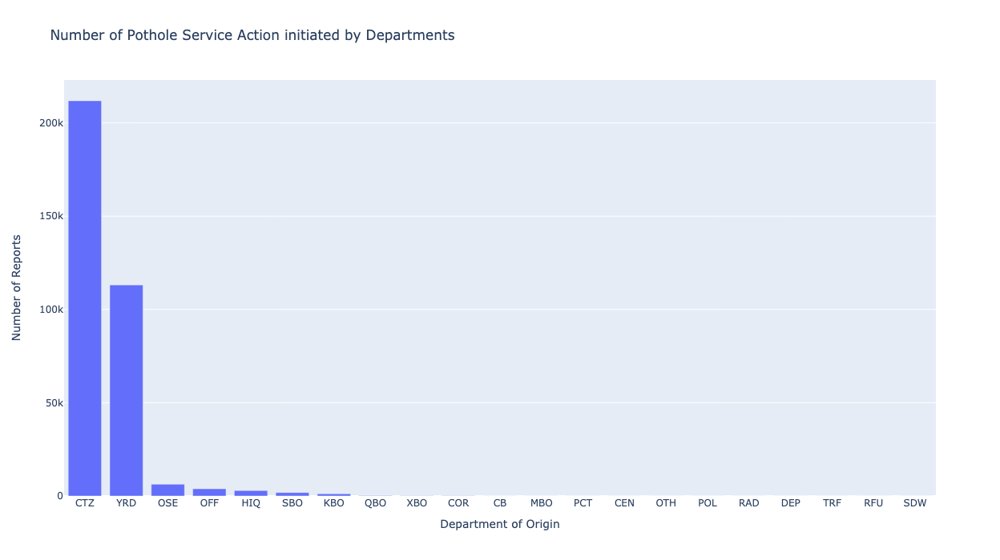

In [160]:
# Plotting the number of reports init

value_counts_Source = updated_df['Source'].value_counts().reset_index() # storing count of values in a variable of "InitBy" column
value_counts_Source.columns = ['Department of Origin', 'Number of Reports'] # accessing columns of the dataframe and assigning value and counts column

fig = px.bar(value_counts_Source, x='Department of Origin', y='Number of Reports', title='Number of Pothole Service Action initiated by Departments')
fig.update_layout(height=700)

# Show the plot
fig.show()

The Citizens and Yard department has contributed most, about 90% of the potholes reports. 

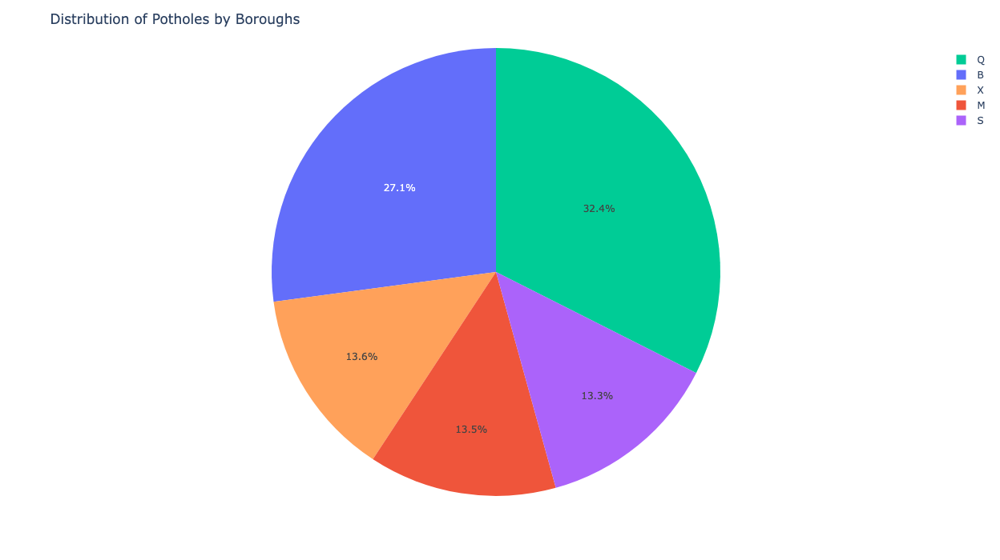

In [161]:
# Plot distribution of Number of Potholes by Boroughs of NYC

fig = px.pie(updated_df, 
             values=updated_df['index'].value_counts().values, 
             names='Boro', color='Boro')
fig.update_layout(title_text='Distribution of Potholes by Boroughs', height=700, width=700)

fig.show()

We can see that the most number of potholes occurences are in Queens and then Brooklyn. We can assume that number of potholes are dependent on the area, population and road networks of Boroughs.

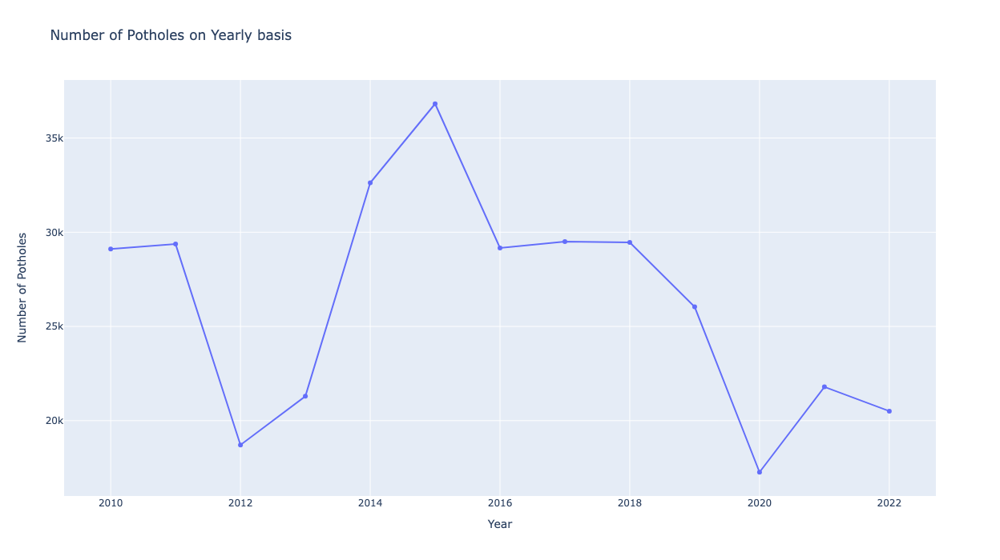

In [162]:
# Plot number of potholes on yearly basis
updated_df['year'] = pd.to_datetime(updated_df['RptDate'], format='%Y') #extracting year

# Group by year and count potholes
potholes_by_year = updated_df.groupby(updated_df['year'].dt.year).size().reset_index(name='potholes_count')

# Create a Plotly line plot
fig = px.line(potholes_by_year, x='year', y='potholes_count', markers=True, title='Number of Potholes on Yearly basis')
fig.update_layout(xaxis_title='Year', yaxis_title='Number of Potholes')
fig.update_layout(height=700)

# Show the plot
fig.show()

In [163]:
potholes_by_year.mean()

year               2016.000000
potholes_count    26281.923077
dtype: float64

The highest number of potholes recorded in NYC in a calendar year was 2015 with slightly over 36K potholes. Overall the yearly average is 24032 potholes per year.

On avegrage it took the relative department 4 days and half to fix a pothole. However, there are few outliers as well which took months to fix a pothole, probably it depends on the size of pothole and complexity involved.

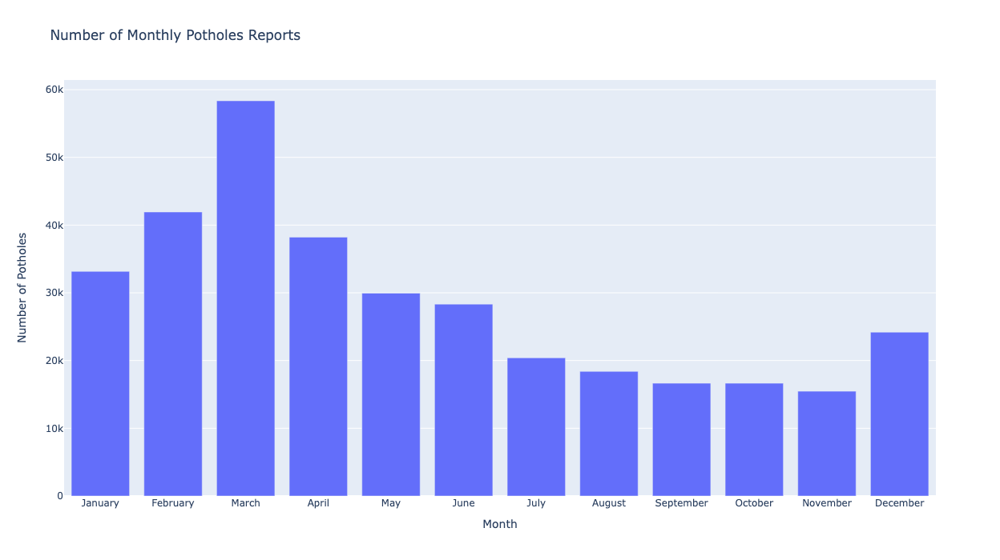

In [164]:
# months with most potholes

# Group by month and calculate the sum of potholes_count
monthly_potholes = updated_df.groupby('month')['index'].count().reset_index()

# Create a Plotly bar chart
fig = px.bar(monthly_potholes, x='month', y='index', title='Number of Monthly Potholes Reports')

fig.update_layout(xaxis_title='Month', yaxis_title='Number of Potholes', height=700)

#plotly is not preserving monthly order so I have to pass the parameters to adjust the monthly order
month_order = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
fig.update_xaxes(categoryorder='array', categoryarray=month_order)


# Show the plot
fig.show()

The trend to note here is that the pothole numbers are maximum in the spring season which helped me to unveil an interesting fact that If the water freezes and thaws over and over, the pavement will weaken and continue cracking. 

### One hot encoding

In [165]:
Boro_value_counts = df['Boro'].value_counts()
source_value_counts = df['Source'].value_counts()
initBy_value_counts = df['InitBy'].value_counts()

print(Boro_value_counts)
print('-' * 50)  # Print a line separator
print(source_value_counts)
print('-' * 50)  # Print a line separator
print(initBy_value_counts)

Boro
Q    118096
B     97365
X     48972
M     48781
S     47471
Name: count, dtype: int64
--------------------------------------------------
Source
CTZ    221543
YRD    122213
OSE      6470
OFF      3884
HIQ      2936
SBO      1861
KBO      1181
QBO       246
XBO       117
COR        78
CB         51
MBO        35
PCT        28
CEN        20
OTH         8
RAD         4
POL         4
DEP         2
TRF         2
SDW         1
RFU         1
Name: count, dtype: int64
--------------------------------------------------
InitBy
YRD    132346
CSC    103318
SPH     66550
ONF     45592
OFF      5217
SBO      4520
HIQ      1264
DOT      1210
QBO       579
XBO        36
MBO        30
KBO        19
CIU         3
COM         1
Name: count, dtype: int64


For the statistical analysis, modelling we need to have our dataset number types. For that I am mapping and converting our string type values to numbers. 

Boro : There are 5 boros in NYC and I am mapping them with numbers.

Source : There are 12 unique values in the source column, I am labeling the top 5 as they are contributing the most and grouping rest as 6

InitBy : There are 14 unique values in the Initby column, I am labeling the top 6 as they are contributing the most and grouping rest as 7

Month : Mapping month name as Numbers.

In [166]:
borough_map = {'B': 1, 'X': 2, 'Q': 3, 'M': 4, 'S': 5}

# Map the borough column to integers
updated_df['Boro_num'] = updated_df['Boro'].map(borough_map)

In [167]:
def map_source_values(source):  # mapping source values
    switch = {
        'CTZ': 1,
        'YRD': 2,
        'OSE': 3,
        'OFF': 4,
        'HIQ': 5
    }
    return switch.get(source, 6)  # Default value is 6 if code is not found in the switch dictionary

# Apply the function to map values
updated_df['Source_num'] = updated_df['Source'].apply(map_source_values)

def map_initby_values(initby):  # mapping InitBy values
    switch = {
        'YRD': 1,
        'CSC': 2,
        'SPH': 3,
        'ONF': 4,
        'OFF': 5,
        'SBO': 6
    }
    return switch.get(initby, 7)  # Default value is 5 if code is not found in the switch dictionary

# Apply the function to map values
updated_df['InitBy_num'] = updated_df['InitBy'].apply(map_initby_values)

In [168]:
def map_months_values(month_name):  # mapping month values
    switch = {
        'January': 1,
        'February': 2,
        'March': 3,
        'April': 4,
        'May': 5,
        'June': 6,
        'July': 7,
        'August': 8,
        'September': 9,
        'October': 10,
        'November': 11,
        'December': 12
        
    }
    return switch.get(month_name, 0)

# Apply the function to map values
updated_df['month_num'] = updated_df['month'].apply(map_months_values)

In [169]:
updated_df.head()

,Unnamed: 0,the_geom,DefNum,InitBy,OFT,OnFaceName,OnPrimName,FrmPrimNam,ToPrimName,Boro,...,DATE,PRCP,SNOW,TMIN,TMAX,year,Boro_num,Source_num,InitBy_num,month_num
0,11,MULTILINESTRING ((-73.92993757815543 40.597146...,DB2010002001,CSC,343910312370314730,GERRITSEN AV,GERRITSEN AVENUE,ALLEN AVENUE,AVENUE W,B,...,2010-01-02,0.02,0.2,17.0,34.0,2010-01-02,1,1,2,1
1,12,MULTILINESTRING ((-73.9393340798436 40.6227256...,DB2010002004,CSC,336480314180354050,E 37 ST,EAST 37 STREET,AVENUE L,KINGS HIGHWAY,B,...,2010-01-02,0.02,0.2,17.0,34.0,2010-01-02,1,1,2,1
2,97384,MULTILINESTRING ((-73.95918180056893 40.771696...,DM2010002002,CSC,110210118490118510,3 AV,3 AVENUE,EAST 75 STREET,EAST 76 STREET,M,...,2010-01-02,0.02,0.2,17.0,34.0,2010-01-02,4,1,2,1
3,97390,MULTILINESTRING ((-73.95918180056893 40.771696...,DM2010003021,YRD,110210118490118510,3 AV,3 AVENUE,EAST 75 STREET,EAST 76 STREET,M,...,2010-01-02,0.02,0.2,17.0,34.0,2010-01-02,4,2,1,1
4,97391,MULTILINESTRING ((-73.95172338255492 40.773656...,DM2010003023,YRD,110010118610118630,1 AV,1 AVENUE,EAST 81 STREET,EAST 82 STREET,M,...,2010-01-02,0.02,0.2,17.0,34.0,2010-01-02,4,2,1,1


In [170]:
updated_df = updated_df.drop(columns=['Unnamed: 0', 'the_geom', 'DefNum', 'InitBy', 'OFT', 'OnFaceName', 'FrmPrimNam', 'ToPrimName' , 'OnPrimName','street_name',  'Source', 'Boro', 'index', 'RptDate', 'RptClosed' , 'month' ,'year', 'neighbour_hood','building_number','DATE'])

Preparing the data for analysis and modelling. Dropping the columns which have already been converted to dummies and labels. Also we have feature engineered the locations as zip codes and street names so I am dropping all columns related to locations as they have large nummber of nulls and I can't impute or replace those. Dropping RptDate and RptClosed as I have feature engineered the month column for seasonality.

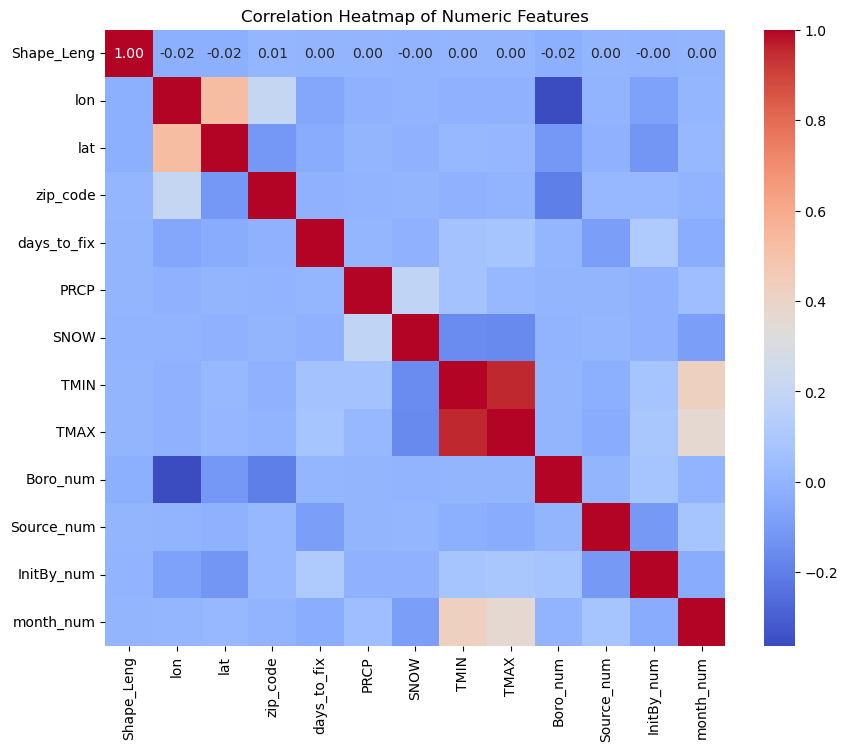

In [171]:
numeric_df = updated_df.select_dtypes(include='number')

# Calculate correlation matrix
corr_matrix = numeric_df.corr()

# Plot correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap of Numeric Features')
plt.show()

Overall there is a trend of negative and zero co-relations between features which is not providing a useful insight to gather the imortance of features for the occurence of potholes. So far latitudes and longitudes have a good correlation with zip code.
Feature name "Shape_Leng" is not actually helping at all. So I am going to drop this feature.

In [172]:
updated_df.dropna(inplace=True)
updated_df.head()

,Shape_Leng,lon,lat,zip_code,days_to_fix,PRCP,SNOW,TMIN,TMAX,Boro_num,Source_num,InitBy_num,month_num
0,82.707368,-73.929938,40.597147,11229,3.0,0.02,0.2,17.0,34.0,1,1,2,1
1,426.877885,-73.939334,40.622726,11210,3.0,0.02,0.2,17.0,34.0,1,1,2,1
2,264.702760,-73.959182,40.771697,10021,2.0,0.02,0.2,17.0,34.0,4,1,2,1
3,264.702760,-73.959182,40.771697,10021,1.0,0.02,0.2,17.0,34.0,4,2,1,1
4,264.464803,-73.951723,40.773657,10028,1.0,0.02,0.2,17.0,34.0,4,2,1,1


In [173]:
X = updated_df.drop(['days_to_fix','Shape_Leng','lat','zip_code', 'PRCP'], axis=1)
y = updated_df['days_to_fix']

In [179]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Fit a linear regression model
linear_reg = LinearRegression()
linear_reg.fit(X_train_scaled, y_train)

# Predict on the test set
y_pred = linear_reg.predict(X_test_scaled)

# Calculate R^2 score
r2 = r2_score(y_test, y_pred)
print("R^2 Score:", r2)

# Calculate Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error (MSE):", mse)

R^2 Score: 0.02507676102248524
Mean Squared Error (MSE): 260.98858848902574


R2 Score: 0.02507676102248524
MSE Score: 260.98858848902574


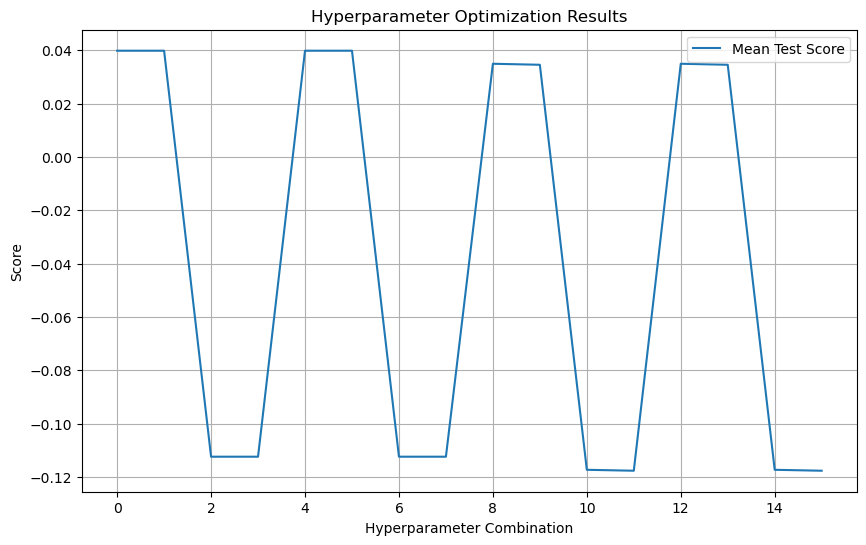

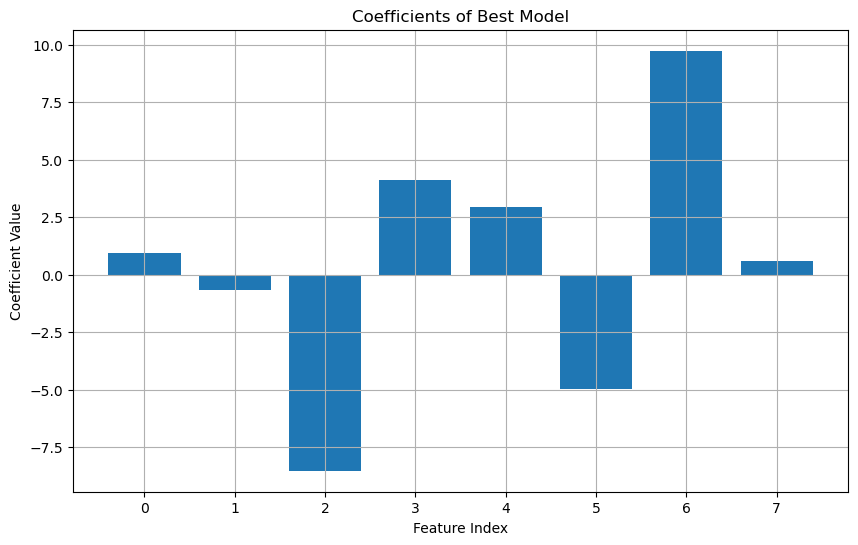

Best Model: Pipeline(steps=[('scaler', MinMaxScaler()), ('pca', PCA()),
                ('regressor', LinearRegression())])


In [180]:

from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a pipeline with preprocessing steps, PCA, and the linear regression model
pipeline = Pipeline([
    ('scaler', StandardScaler()),  # StandardScaler
    ('pca', PCA()),  # PCA
    ('regressor', LinearRegression())  # Linear Regression
])

# Define hyperparameters for GridSearchCV
parameters = {
    'scaler': [StandardScaler(), MinMaxScaler()],  # Scaler options
    'pca__n_components': [None, 5, 10, 15],  # Number of principal components
    'regressor__fit_intercept': [True, False],  # Whether to fit intercept
    'regressor__copy_X': [True, False],  # Whether to copy X
}

# Perform GridSearchCV
grid_search = GridSearchCV(pipeline, parameters, cv=5, n_jobs=-1)
grid_search.fit(X_train, y_train)

# Get the best model
best_model = grid_search.best_estimator_

# Get the best features
best_features = best_model.named_steps['pca'].components_

# Make predictions
y_pred = best_model.predict(X_test)

# Calculate R2 score
r2 = r2_score(y_test, y_pred)

# Calculate MSE score
mse = mean_squared_error(y_test, y_pred)

# Print scores
print("R2 Score:", r2)
print("MSE Score:", mse)

# Plot R2 score and MSE score
plt.figure(figsize=(10, 6))
plt.plot(grid_search.cv_results_['mean_test_score'], label='Mean Test Score')
plt.xlabel('Hyperparameter Combination')
plt.ylabel('Score')
plt.title('Hyperparameter Optimization Results')
plt.legend()
plt.grid(True)
plt.show()

# Plot coefficients
plt.figure(figsize=(10, 6))
plt.bar(range(len(best_model.named_steps['regressor'].coef_)), best_model.named_steps['regressor'].coef_)
plt.xlabel('Feature Index')
plt.ylabel('Coefficient Value')
plt.title('Coefficients of Best Model')
plt.grid(True)
plt.show()

# Print best model
print("Best Model:", best_model)

In [181]:
from sklearn.linear_model import Ridge

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Fit a Ridge regression model
alpha = 1.0  # Regularization strength
ridge = Ridge(alpha=alpha)
ridge.fit(X_train_scaled, y_train)

# Get the absolute coefficients
absolute_coefficients = abs(ridge.coef_)

# Find the indices of the most important features (top k features)
num_features_to_select = 11
top_indices = absolute_coefficients.argsort()[-num_features_to_select:][::-1]

# Print the most important features
print("Most important features:")
for idx in top_indices:
    print(f"Feature {idx}: {absolute_coefficients[idx]}")

# Predict on the test set
y_pred = ridge.predict(X_test_scaled)

# Calculate R^2 score
r2 = r2_score(y_test, y_pred)
print("R^2 Score:", r2)
# Calculate Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error (MSE):", mse)

Most important features:
Feature 3: 1.9420837929233477
Feature 6: 1.3093532506568581
Feature 5: 1.068340920770632
Feature 2: 0.8108437978920481
Feature 0: 0.8086886273333651
Feature 7: 0.6486735378523251
Feature 4: 0.2865427882560681
Feature 1: 0.04802895446058093
R^2 Score: 0.025076733261857886
Mean Squared Error (MSE): 260.98859592059233


In [182]:
from sklearn.ensemble import RandomForestRegressor

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Fit a Random Forest Regressor
rf_regressor = RandomForestRegressor(n_estimators=100, random_state=42)
rf_regressor.fit(X_train_scaled, y_train)

# Predict on the test set
y_pred = rf_regressor.predict(X_test_scaled)

# Calculate R^2 score
r2 = r2_score(y_test, y_pred)
print("R^2 Score:", r2)

# Calculate Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error (MSE):", mse)

R^2 Score: -0.3329742870136987
Mean Squared Error (MSE): 356.83945540649313


In [184]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.ensemble import RandomForestRegressor

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a pipeline with preprocessing steps, PCA, and the Random Forest Regressor model
pipeline = Pipeline([
    ('scaler', StandardScaler()),  # StandardScaler
    ('pca', PCA()),  # PCA
    ('regressor', RandomForestRegressor())  # Random Forest Regressor
])

# Define hyperparameters for GridSearchCV
parameters = {
    'scaler': [StandardScaler(), MinMaxScaler()],  # Scaler options
    'pca__n_components': [None, 5, 10, 15],  # Number of principal components
    'regressor__n_estimators': [50, 100, 200],  # Number of trees in the forest
    'regressor__max_depth': [None, 5, 10, 20],  # Maximum depth of the tree
    'regressor__min_samples_split': [2, 5, 10],  # Minimum number of samples required to split a node
    'regressor__min_samples_leaf': [1, 2, 4]  # Minimum number of samples required at each leaf node
}

# Perform GridSearchCV
grid_search = GridSearchCV(pipeline, parameters, cv=5)
grid_search.fit(X_train, y_train)

# Get the best model
best_model = grid_search.best_estimator_

# Get the best features
best_features = best_model.named_steps['pca'].components_

# Make predictions
y_pred = best_model.predict(X_test)

# Calculate R2 score
r2 = r2_score(y_test, y_pred)

# Calculate MSE score
mse = mean_squared_error(y_test, y_pred)

# Print scores
print("R2 Score:", r2)
print("MSE Score:", mse)

# Plot R2 score and MSE score
plt.figure(figsize=(10, 6))
plt.plot(grid_search.cv_results_['mean_test_score'], label='Mean Test Score')
plt.xlabel('Hyperparameter Combination')
plt.ylabel('Score')
plt.title('Hyperparameter Optimization Results')
plt.legend()
plt.grid(True)
plt.show()

# Print best model
print("Best Model:", best_model)

KeyboardInterrupt: 

##### Predict lat and long

R2 Score: 0.15673094860085257
MSE Score: 0.01030294048998777


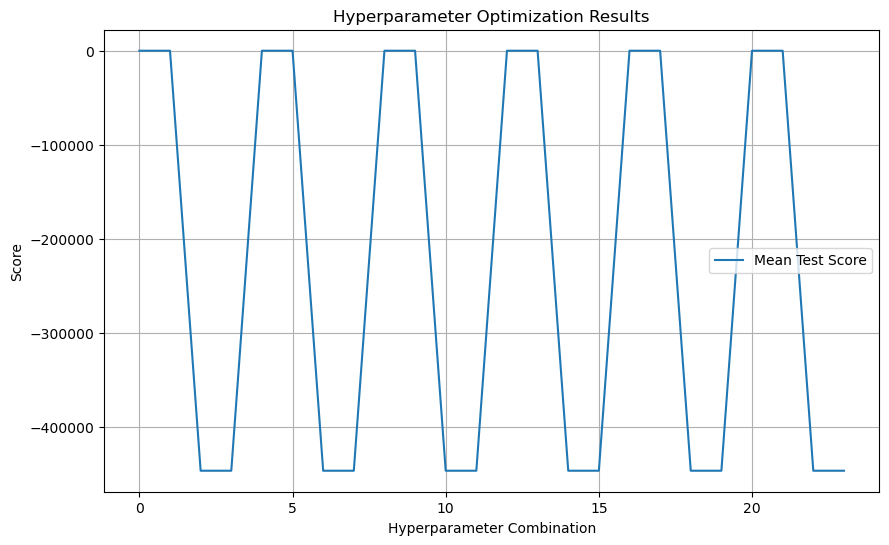

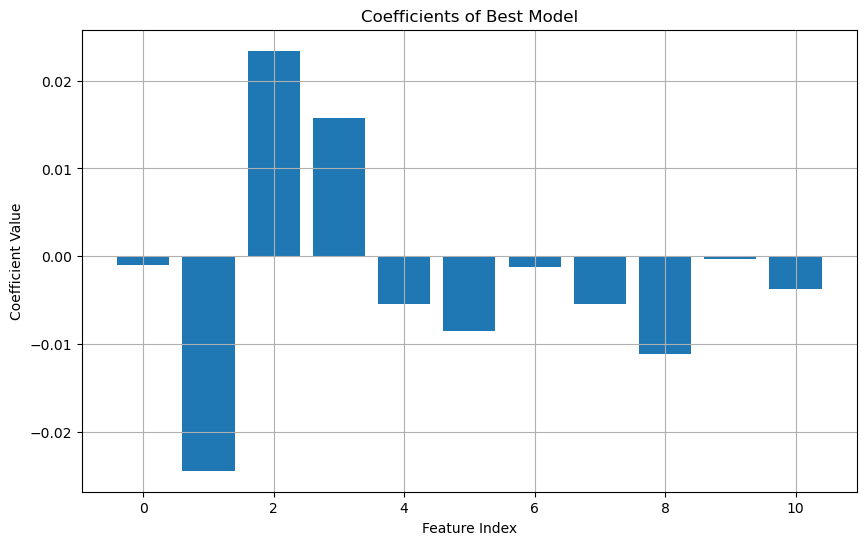

Best Model: Pipeline(steps=[('scaler', StandardScaler()), ('pca', PCA()),
                ('regressor', LinearRegression())])


In [186]:
X = updated_df.drop(['lat','lon'], axis=1)
y = updated_df['lon']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a pipeline with preprocessing steps, PCA, and the linear regression model
pipeline = Pipeline([
    ('scaler', StandardScaler()),  # StandardScaler
    ('pca', PCA()),  # PCA
    ('regressor', LinearRegression())  # Linear Regression
])

# Define hyperparameters for GridSearchCV
parameters = {
    'scaler': [StandardScaler(), MinMaxScaler()],  # Scaler options
    'pca__n_components': [None, 5, 10, 15],  # Number of principal components
    'regressor__fit_intercept': [True, False],  # Whether to fit intercept
    'regressor__copy_X': [True, False],  # Whether to copy X
}

# Perform GridSearchCV
grid_search = GridSearchCV(pipeline, parameters, cv=5, n_jobs=-1)
grid_search.fit(X_train, y_train)

# Get the best model
best_model = grid_search.best_estimator_

# Get the best features
best_features = best_model.named_steps['pca'].components_

# Make predictions
y_pred = best_model.predict(X_test)

# Calculate R2 score
r2 = r2_score(y_test, y_pred)

# Calculate MSE score
mse = mean_squared_error(y_test, y_pred)

# Print scores
print("R2 Score:", r2)
print("MSE Score:", mse)

# Plot R2 score and MSE score
plt.figure(figsize=(10, 6))
plt.plot(grid_search.cv_results_['mean_test_score'], label='Mean Test Score')
plt.xlabel('Hyperparameter Combination')
plt.ylabel('Score')
plt.title('Hyperparameter Optimization Results')
plt.legend()
plt.grid(True)
plt.show()

# Plot coefficients
plt.figure(figsize=(10, 6))
plt.bar(range(len(best_model.named_steps['regressor'].coef_)), best_model.named_steps['regressor'].coef_)
plt.xlabel('Feature Index')
plt.ylabel('Coefficient Value')
plt.title('Coefficients of Best Model')
plt.grid(True)
plt.show()

# Print best model
print("Best Model:", best_model)

#### PCA analysis

Explained Variance Ratio: [0.17482196 0.13639724 0.09414066 0.09027501 0.08897734 0.07687188
 0.06974195 0.06682053 0.05996819 0.05610779 0.05442535 0.02823615
 0.00321594]


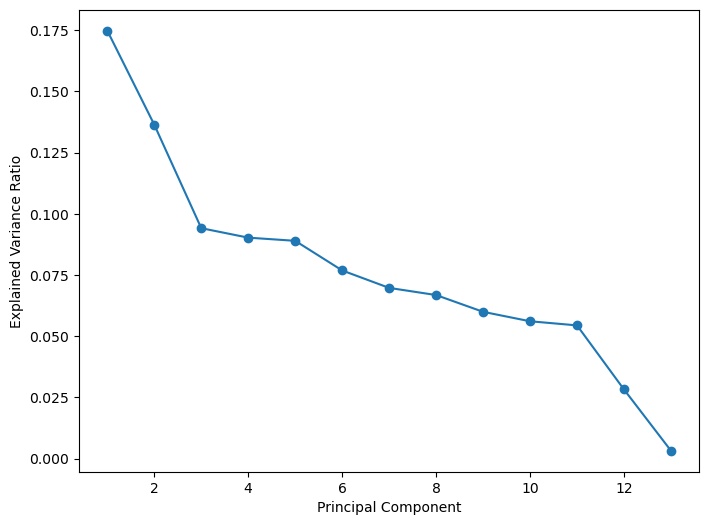

In [183]:
scaler = StandardScaler()
scaled_features = scaler.fit_transform(numeric_df)

pca = PCA()
principal_components = pca.fit_transform(scaled_features)

explained_variance_ratio = pca.explained_variance_ratio_
print("Explained Variance Ratio:", explained_variance_ratio)

# Step 4: Scree Plot
plt.figure(figsize=(8, 6))
plt.plot(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio, marker='o', linestyle='-')
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.show()